# **Range Azimuth**

In [1]:
import sys
import numpy as np
import matplotlib.pyplot as plt

sys.path.insert(0, '..')
# from utils.radar_params import *

%matplotlib inline

In [1]:
num_rx = 4
num_tx = 2
start_freq = 77 # GHz
idle_time = 100 # usec
ramp_end_time = 63.14 # usec
chirp_slope =  29.982 # MHz/usec
num_adc_samples = 256
adc_sample_rate = 10 #Msps
print(f"Number of Rx Antennas: {num_rx}")
print(f"Number of Tx Antennas: {num_tx}")
print(f"Start Frequency: {start_freq} GHz")
print(f"Idle Time: {idle_time} usec")
print(f"Ramp End Time: {ramp_end_time} usec") # this should really be called ramp to end? or maybe just chirptime?
print(f"Chirp Slope: {chirp_slope} MHz/usec")
print(f"Number of ADC Samples: {num_adc_samples}")
print(f"ADC sample rate: {adc_sample_rate} Msps")

Number of Rx Antennas: 4
Number of Tx Antennas: 2
Start Frequency: 77 GHz
Idle Time: 100 usec
Ramp End Time: 63.14 usec
Chirp Slope: 29.982 MHz/usec
Number of ADC Samples: 256
ADC sample rate: 10 Msps


In [3]:
LIGHT_SPEED = 299792458 # m/s

def compute_range_resolution(adc_sample_rate, num_adc_samples, chirp_slope):
    """
        Compute Range Resolution in meters
        Inputs:
            adc_sample_rate (Msps)
            num_adc_samples (unitless)
            chirp_slope (MHz/usec)
        Outputs:
            range_resolution (meters)
    """

    # compute ADC sample period T_c in msec
    adc_sample_period = (1 / adc_sample_rate) * num_adc_samples # usec
    print(f'adc sample period: {adc_sample_period} usec')

    # next compute the Bandwidth in MHz
    bandwidth = adc_sample_period * chirp_slope # MHz
    print(f'bandwidth:{bandwidth} MHz')

    # Coompute range resolution in meters
    range_resolution = LIGHT_SPEED / (2 * (bandwidth * 1e6)) # meters

    return range_resolution, bandwidth


def compute_doppler_resolution(num_chirps, bandwidth, chirp_interval, num_tx):
    """
        Compute Doppler Resolution in meters/second
        Inputs:
            num_chirps
            bandwidth - bandwidth of each chirp (MHz)
            chirp_interval - total interval of a chirp including idle time (usec)
            num_tx
        Outputs:
            doppler_resolution (ms)
    """
    # compute center frequency in GHz
    center_freq = (77 + (bandwidth*1e-3)/2) # GHz

    # compute center wavelength 
    lmbda = LIGHT_SPEED/(center_freq * 1e9) # meters

    # compute doppler resolution in meters/second
    doppler_resolution = lmbda / (2 * num_chirps * num_tx * chirp_interval)

    return doppler_resolution

In [4]:
def forward_backward_avg(Rxx):
    """ Performs forward backward averaging on the given input square matrix
    Args:
        Rxx (ndarray): A 2D-Array square matrix containing the covariance matrix for the given input data
    Returns:
        R_fb (ndarray): The 2D-Array square matrix containing the forward backward averaged covariance matrix
    """
    assert np.size(Rxx, 0) == np.size(Rxx, 1)

    # --> Calculation
    M = np.size(Rxx, 0)  # Find number of antenna elements
    Rxx = np.matrix(Rxx)  # Cast np.ndarray as a np.matrix

    # Create exchange matrix
    J = np.eye(M)  # Generates an identity matrix with row/col size M
    J = np.fliplr(J)  # Flips the identity matrix left right
    J = np.matrix(J)  # Cast np.ndarray as a np.matrix

    R_fb = 0.5 * (Rxx + J * np.conjugate(Rxx) * J)

    return np.array(R_fb)


def aoa_capon(x, a):
    """ Computes Capon Spectrum
        Inputs:
            x - output of 1D range FFT (v_rtx, num_chirps)
            a - steering vector (num_angles, v_rtx)
        Outputs:
            capon_spectrum - Computed Capon Spectrum (num_angles)
    """
    # perturbation
    p = np.eye(x.shape[0]) * 1e-9

    Rxx = x @ np.conj(x).T
    Rxx = forward_backward_avg(Rxx)

    Rxx_inv = np.linalg.inv(Rxx + p)

    capon_spec = np.reciprocal(np.einsum('ij,ij->i', a.conj(), (Rxx_inv @ a.T).T))
    
    return capon_spec


def compute_steering_vector(num_ant=8, angle_res=1, angle_rng=90):
    """ Computes array of Steering Vectors for a desired angluar range
        and resolution. **This is a special function that only computes the
        steering vectors along a 1D linear axis.**
        Inputs:
            angle_res - angle resolution in degrees
            angle_rng - single sided angle range
            num_ant - number of virtual antennas
        Output:
            steering_vectors
    """
    # get number of steering vectors based on desired angle range and resolution
    num_vec = (2 * angle_rng / angle_res + 1)
    num_vec = int(round(num_vec))

    # convert to radians
    angle_rng = angle_rng*np.pi/180
    angle_res = angle_res*np.pi/180

    # compute steering vectors
    steering_vectors = np.zeros((num_vec, num_ant), dtype=np.complex64)
    for k in range(num_vec):
        for m in range(num_ant):
            steering_vectors[k, m] = np.exp(-1j*np.pi*m
                                            *np.sin(-angle_rng + k*angle_res))
            
    return steering_vectors


In [6]:
num_samples = 256
num_chirps = 204
num_frames = 256
num_rx = 4
num_tx = 2
# num_chirps *= num_tx

path = '../rawData/cap6/data_Raw_0.bin'
rad_range = np.arange(start=0, stop=np.pi, step=np.pi/(num_samples))
rad_doppler = np.arange(start=-np.pi/2, stop=np.pi/2, step=np.pi/(num_chirps//2))

adc_raw = np.fromfile(path, dtype=np.int16)
print(f'adc_raw shape:{adc_raw.shape}')

nframes = adc_raw.shape[0] // (num_samples*num_chirps*num_rx)
assert adc_raw.shape[0] == num_samples*num_chirps*num_rx*num_frames or 0 < nframes <num_frames
print(f'{nframes} received')
adc_raw = adc_raw[ :num_samples*num_chirps*num_rx*nframes]

adc_frames = adc_raw.reshape(nframes, num_chirps, num_rx, num_samples)
adc_tx1 = adc_frames[:, ::2, :, :]
adc_tx2 = adc_frames[:, 1::2, :, :]
adc_frames = np.concatenate([adc_tx1, adc_tx2], axis=-2)
print(f'tx1:{adc_tx1.shape}, tx2:{adc_tx2.shape}, virtual:{adc_frames.shape}')

adc_data = adc_frames[30]
print(f'adc_data shape:{adc_data.shape}')

adc_raw shape:(53477376,)
256 received
tx1:(256, 102, 4, 256), tx2:(256, 102, 4, 256), virtual:(256, 102, 8, 256)
adc_data shape:(102, 8, 256)


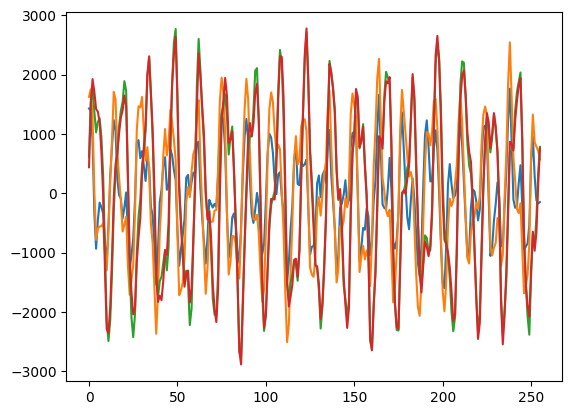

In [8]:
plt.plot(adc_frames[20, 50, 1])
plt.plot(adc_frames[20, 100, 1])

plt.plot(adc_frames[60, 50, 1])
plt.plot(adc_frames[60, 100, 1])

In [9]:
# range_resolution, bandwidth = compute_range_resolution(adc_sample_rate, num_adc_samples, chirp_slope)
bandwidth = chirp_slope*ramp_end_time*1e6
range_resolution = LIGHT_SPEED/(2*bandwidth)
max_range = range_resolution * num_adc_samples
print(f'range_resolution: {range_resolution}, max_range: {max_range}')

num_chirps = adc_data.shape[0]
chirp_interval = (ramp_end_time + idle_time) * 1e-6 # usec

doppler_resolution = compute_doppler_resolution(num_chirps, bandwidth, chirp_interval, num_tx)
max_doppler = doppler_resolution * num_chirps / 2

print(f'doppler_resolution: {doppler_resolution}, doppler_resolution: {max_doppler}')

ranges = np.arange(0, max_range + range_resolution, range_resolution)
range_ticks = np.arange(0, len(ranges), len(ranges)//10)
range_tick_labels = ranges[::len(ranges)//10].round(2)

range_resolution: 0.07918182912704015, max_range: 20.27054825652228
doppler_resolution: 4.7580562489978115e-06, doppler_resolution: 0.0002426608686988884


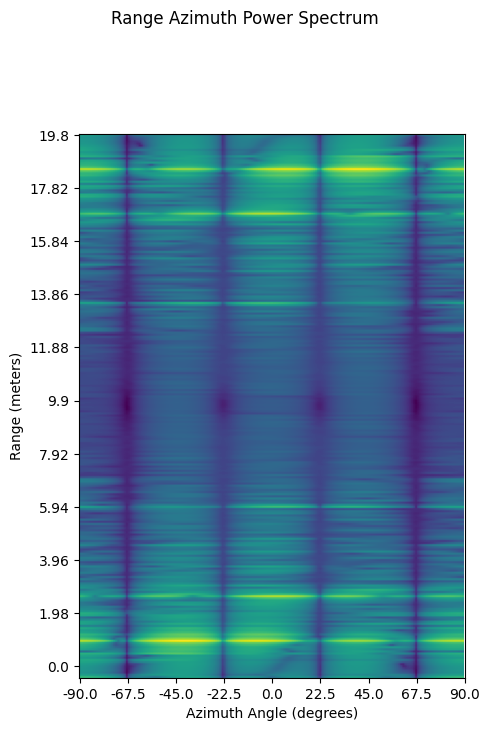

In [10]:
# perform Fast Time Range FFT
range_cube = np.fft.fft(adc_data, axis=2).transpose(2, 1, 0) #[range, channel, doppler]
# perform Slow Time Doppler FFT
range_doppler = np.fft.fftshift(np.fft.fft(range_cube, axis=2), axes=2) #[range, channel, doppler]

# zero pad along the antennas
range_doppler_padded = np.pad(range_doppler, pad_width=[(0, 0), (86, 87), (0, 0)], mode='constant')

# perform FFT over azimuth 
az_fft = np.fft.fftshift(np.fft.fft(range_doppler_padded, axis=1), axes=1)
# az_fft = np.fft.fftshift(az_fft, axes=0)
# Compute Power Spectrum
az_power = np.abs(az_fft)**2
beamformed_img = np.mean(np.flipud(az_power), axis=2)

fig, ax = plt.subplots(1, 1, figsize=(5, 8))
ax.imshow(np.log10(beamformed_img));
fig.suptitle("Range Azimuth Power Spectrum");
ax.set_xlabel("Azimuth Angle (degrees)");
ax.set_ylabel("Range (meters)");

# apply Range and Doppler labels
ax.set_yticks(range_ticks, range_tick_labels[::-1]);

ax.set_xticks(np.linspace(0, 181, 9), np.linspace(-90, 90, 9).round(1));
# fig.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap), ax=ax)
plt.tight_layout();

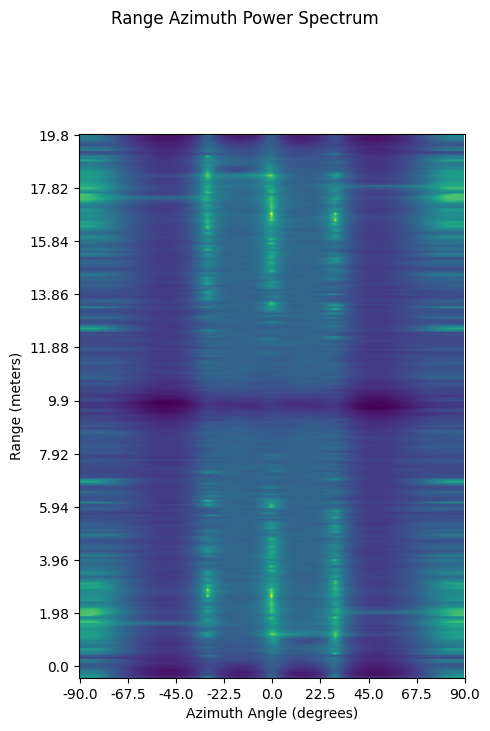

In [11]:
steering_vector = compute_steering_vector(num_ant=8, angle_res=1.0, angle_rng=90)
steering_vector.shape
# plt.plot(-np.abs(steering_vector[:, :].std(axis=1))**2)

n_range_bins = range_doppler.shape[0]
n_angles = steering_vector.shape[0]

range_azimuth = np.zeros((n_range_bins, n_angles), dtype=np.complex64)

for i in range(range_doppler.shape[0]):
    range_azimuth[i,:] = aoa_capon(range_doppler[i, ...], steering_vector)

# range_azimuth = np.fft.fftshift(range_azimuth, axes=0)
range_azimuth = np.flipud(range_azimuth)

fig, ax = plt.subplots(1, 1, figsize=(5, 8))
ax.imshow(10*np.log10(np.abs(range_azimuth)));
fig.suptitle("Range Azimuth Power Spectrum");
ax.set_xlabel("Azimuth Angle (degrees)");
ax.set_ylabel("Range (meters)");

# apply Range and Doppler labels
ax.set_yticks(range_ticks, range_tick_labels[::-1]);

ax.set_xticks(np.linspace(0, 181, 9), np.linspace(-90, 90, 9).round(1));

plt.tight_layout();

In [16]:
import imageio
reader = imageio.get_reader('../rawData/cap6/socket_cap6.mp4', 'ffmpeg')
fps = 30# reader.get_meta_data()["fps"]
duration = reader.get_meta_data()["duration"]
expected_frames = int(fps * duration)
discard_frames = fps*60 # radar takes about 1 min to start 
print(f'fps:{fps}, duration:{duration}, expected_frames:{expected_frames}')
frames = []
for i, frame in enumerate(reader):
    if i < discard_frames:
        del frame
    else:
        frames.append(frame)

fps:30, duration:150.57, expected_frames:4517


In [25]:
from PIL import Image
print(len(frames))
fps=30
radar_duration = 68 # sec
fps_save = 5
# fps_radar = 15
start = 206
frame_nums = []
for i in np.arange(start=start, step=fps//fps_save, stop=start+radar_duration*fps):
    im = Image.fromarray(frames[i])
    im.save(f'../rawData/cap6/frames/frame_{i}.png')
    # im.show()
    frame_nums.append(i)
print(f'frame nums: {frame_nums}')

2718
frame nums: [206, 212, 218, 224, 230, 236, 242, 248, 254, 260, 266, 272, 278, 284, 290, 296, 302, 308, 314, 320, 326, 332, 338, 344, 350, 356, 362, 368, 374, 380, 386, 392, 398, 404, 410, 416, 422, 428, 434, 440, 446, 452, 458, 464, 470, 476, 482, 488, 494, 500, 506, 512, 518, 524, 530, 536, 542, 548, 554, 560, 566, 572, 578, 584, 590, 596, 602, 608, 614, 620, 626, 632, 638, 644, 650, 656, 662, 668, 674, 680, 686, 692, 698, 704, 710, 716, 722, 728, 734, 740, 746, 752, 758, 764, 770, 776, 782, 788, 794, 800, 806, 812, 818, 824, 830, 836, 842, 848, 854, 860, 866, 872, 878, 884, 890, 896, 902, 908, 914, 920, 926, 932, 938, 944, 950, 956, 962, 968, 974, 980, 986, 992, 998, 1004, 1010, 1016, 1022, 1028, 1034, 1040, 1046, 1052, 1058, 1064, 1070, 1076, 1082, 1088, 1094, 1100, 1106, 1112, 1118, 1124, 1130, 1136, 1142, 1148, 1154, 1160, 1166, 1172, 1178, 1184, 1190, 1196, 1202, 1208, 1214, 1220, 1226, 1232, 1238, 1244, 1250, 1256, 1262, 1268, 1274, 1280, 1286, 1292, 1298, 1304, 1310, 1316,

radar shape:  (256, 102, 8, 256)
rgb shape:  (340, 1080, 1920, 3)


C:\Users\juntingd\AppData\Local\Temp\ipykernel_75912\4073228671.py:78: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig3, ax3 = plt.subplots(1, 2, figsize=(12, 5), frameon=False)


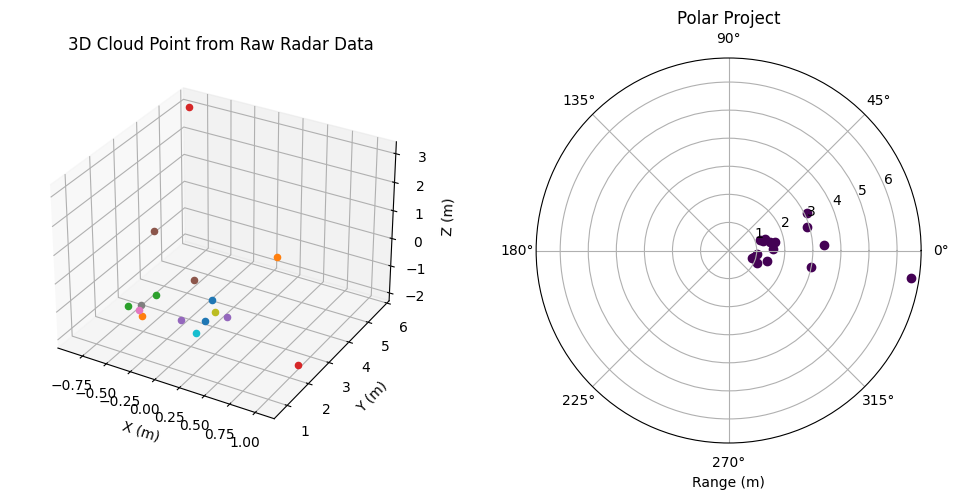

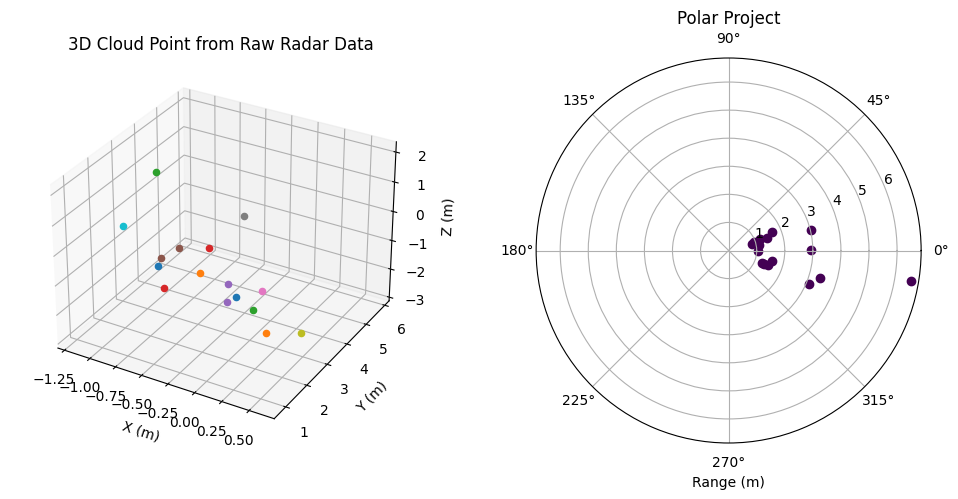

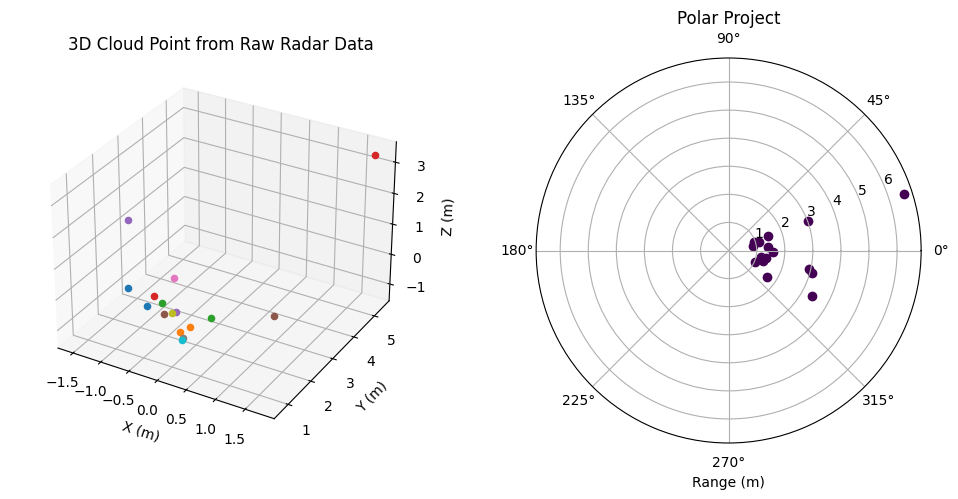

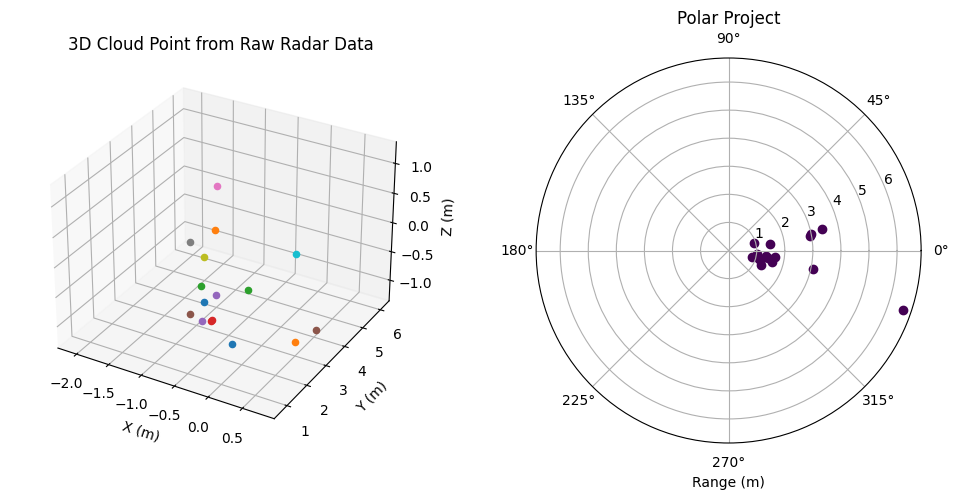

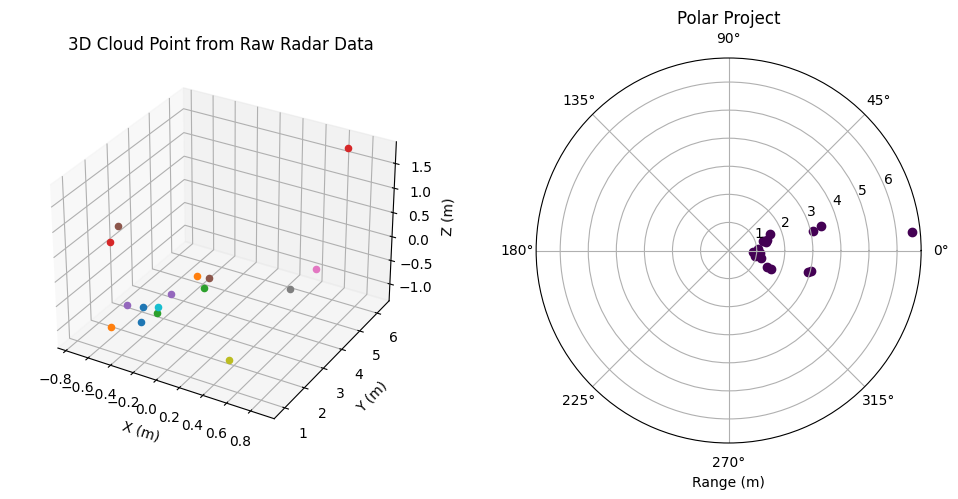

...

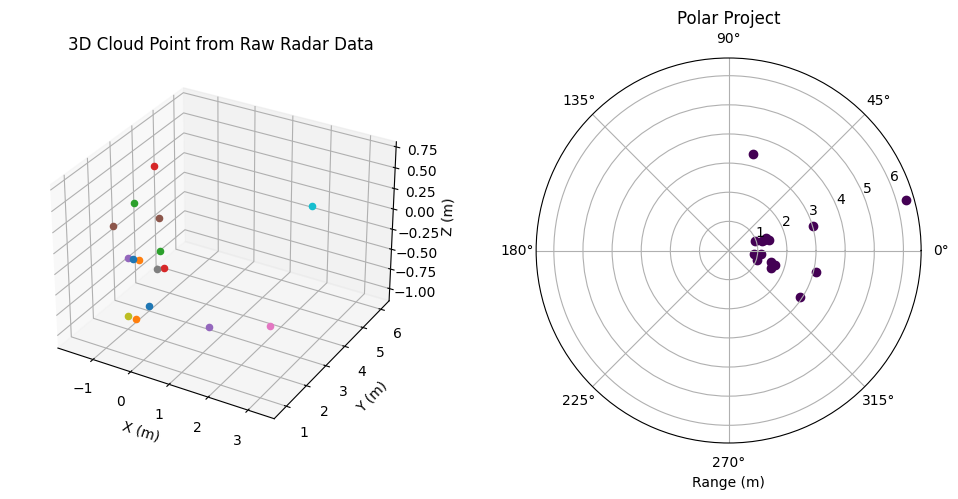

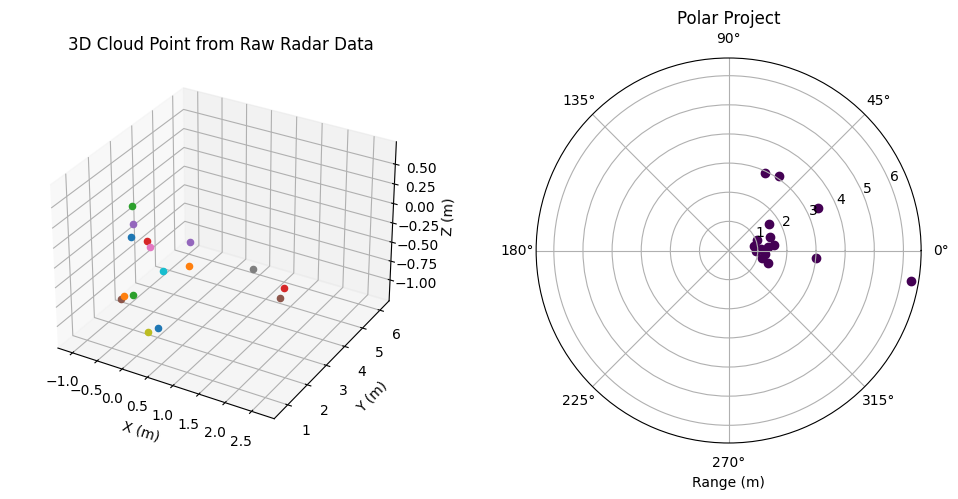

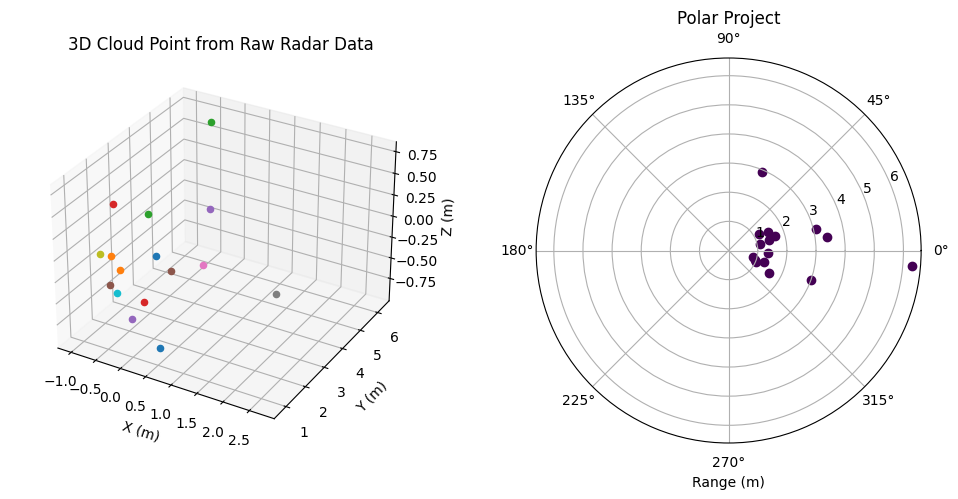

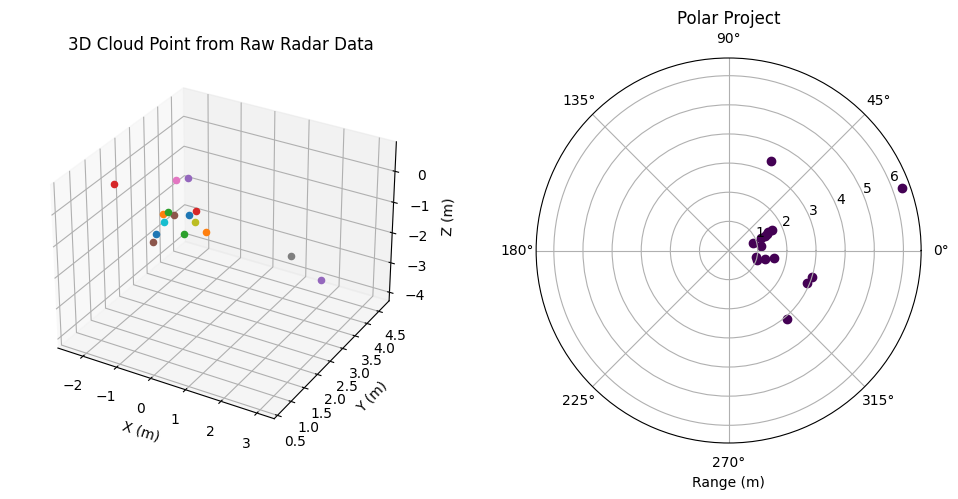

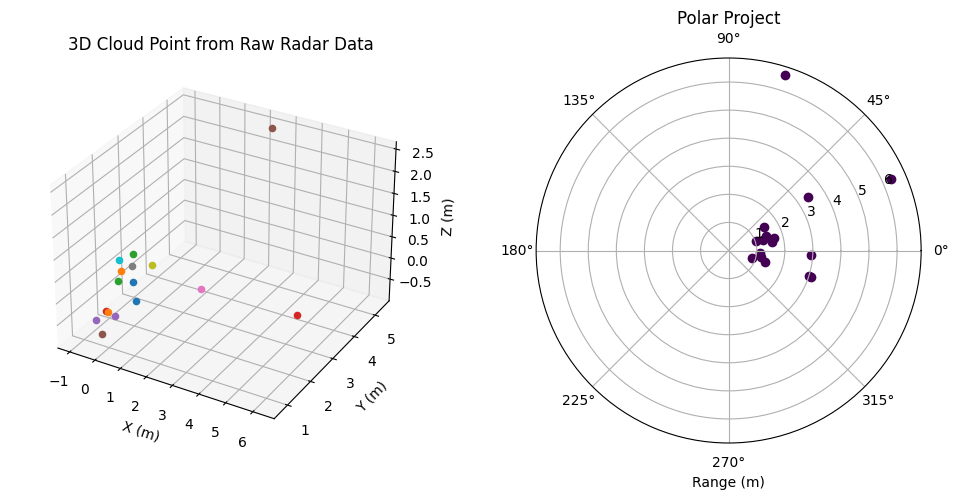

In [26]:
import cv2
from matplotlib.backends.backend_agg import FigureCanvas
frames_stack = []
data_dict = {}
data_dict['radar'] = adc_frames # [frames, chirps, channels, samples]
data_dict['rgb'] = np.array([frames[frame_i] for frame_i in frame_nums])
print('radar shape: ', data_dict['radar'].shape)
print('rgb shape: ', data_dict['rgb'].shape)

NUM_RX=num_rx
NUM_SAMPLES=num_samples
NUM_CHIRPS=num_chirps
NUM_FRAMES_=num_frames
RANGE_FFT_SIZE = NUM_SAMPLES
DOPPLER_FFT_SIZE = NUM_CHIRPS
ELEVATION_DIM=num_tx
AZIMUTH_DIM=num_rx
ELEVATION_FFT_SIZE=32
AZIMUTH_FFT_SIZE=128

for i in range(min(len(data_dict['radar']), len(data_dict['rgb']))):

    # get raw ADC data
    adc_data = data_dict['radar'][i, ...]

    # perform Fast Time Range FFT
    range_cube = np.fft.fft(adc_data, axis=2).transpose(2, 1, 0)

    # perform Slow Time Doppler FFT
    range_doppler = np.fft.fftshift(np.fft.fft(range_cube, axis=2), axes=2)

    # perform FFT over azimuth 
    range_doppler_padded = np.pad(range_doppler, pad_width=[(0, 0), (86, 87), (0, 0)], mode='constant')
    az_fft = np.fft.fftshift(np.fft.fft(range_doppler_padded, axis=1), axes=1)
    az_fft = np.fft.fftshift(az_fft, axes=0)
    # Compute Power Spectrum
    az_power = np.abs(az_fft)**2
    beamformed_img = 10*np.log10(np.mean(az_power, axis=2))

    # compute Capon Spectrum
    range_azimuth = np.zeros((n_range_bins, n_angles), dtype=np.complex64)

    for j in range(range_doppler.shape[0]):
        range_azimuth[j,:] = aoa_capon(range_doppler[j, ...], steering_vector)

    # range_azimuth = np.fft.fftshift(range_azimuth, axes=0)
    # range_azimuth = 20*np.log10(np.abs(range_azimuth))
    range_azimuth = 20*np.log10(np.abs(np.flipud((range_azimuth))))

    # # convert to normalized uint8 to save with opencv video writer
    range_azimuth = cv2.normalize(range_azimuth, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8UC1)
    range_azimuth = range_azimuth[:, :, None].repeat(3, axis=2) # make 3 channel
    beamformed_img = cv2.normalize(beamformed_img, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8UC1)
    beamformed_img = beamformed_img[:, :, None].repeat(3, axis=2) # make 3 channel
    # print(f'range_azimuth shape:{range_azimuth.shape}')

    ### Point Cloud ####
    # Peak detection over doppler/range
    doppler_abs = np.abs(range_doppler.transpose(2, 1, 0))  # shape: (doppler, virtual_ant, range)
    power_map = np.mean(doppler_abs, axis=1)[:, :NUM_SAMPLES//2]  # sum over virtual antennas
    # print(f'power_map shape:{power_map.shape}')

    npoints = 16
    indices = np.argpartition(power_map.flatten(), -npoints)[-npoints: ]
    peak_idx = np.unravel_index(indices, power_map.shape)
    doppler_bins, range_bins = peak_idx
    # print(f'doppler peak: {peak_idx}')

    azimuth_axis = (1/0.5)*np.linspace(-AZIMUTH_FFT_SIZE/2, AZIMUTH_FFT_SIZE/2, AZIMUTH_FFT_SIZE)/AZIMUTH_FFT_SIZE
    elevation_axis = (1/0.8)*np.linspace(-ELEVATION_FFT_SIZE/2, ELEVATION_FFT_SIZE/2, ELEVATION_FFT_SIZE)/ELEVATION_FFT_SIZE
    # print(f'azimuth range:{azimuth_axis.min():.2f} ~ {azimuth_axis.max():.2f}')
    # print(f'elevation range:{elevation_axis.min():.2f} ~ {elevation_axis.max():.2f}')
    azimuth_axis = np.arcsin(azimuth_axis)
    elevation_axis = np.arcsin(elevation_axis)
    # print(f'azimuth angle range:{(180/np.pi)*azimuth_axis.min():.2f} ~ {(180/np.pi)*azimuth_axis.max():.2f}')
    # print(f'elevation angle range:{(180/np.pi)*elevation_axis.min():.2f} ~ {(180/np.pi)*elevation_axis.max():.2f}')

    fig3, ax3 = plt.subplots(1, 2, figsize=(12, 5), frameon=False)
    canvas = FigureCanvas(fig3)
    for spine in ax3[0].spines.values():
        spine.set_visible(False)
    for spine in ax3[1].spines.values():
        spine.set_visible(False)
    ax3[0].axis('off')
    ax3[1].axis('off')
    ax3[0] = fig3.add_subplot(1, 2, 1, projection='3d')
    ax3[1] = fig3.add_subplot(1, 2, 2, projection='polar')
    # ax = fig.add_subplot(121, projection='polar')
    for doppler_bin, range_bin in zip(doppler_bins, range_bins):
        # AoA estimation
        snapshot = range_doppler[doppler_bin, :, range_bin]  # shape: (8,)
        antenna_2d = snapshot.reshape(ELEVATION_DIM, AZIMUTH_DIM)

        angle_fft2d = np.fft.fftshift(np.fft.fft2(antenna_2d, s=(ELEVATION_FFT_SIZE, AZIMUTH_FFT_SIZE)))
        angle_power = np.abs(angle_fft2d) ** 2
        angle_power /= np.max(angle_power)

        # Estimate azimuth and elevation angles
        elev_bin, azim_bin = np.unravel_index(np.argmax(angle_power), angle_power.shape)

        # azimuth_axis = np.arcsin(np.linspace(-1, 1, AZIMUTH_FFT_SIZE))
        # elevation_axis = np.arcsin(np.linspace(-1, 1, ELEVATION_FFT_SIZE))
        theta = azimuth_axis[azim_bin]
        phi = elevation_axis[elev_bin]

        # Range to Cartesian conversion
        r = range_bin * range_resolution
        x = r * np.cos(phi) * np.sin(theta)
        y = r * np.cos(phi) * np.cos(theta)
        z = r * np.sin(phi)
        # print(f'azim_bin:{azim_bin}, elev_bin:{elev_bin}, theta:{(180/np.pi)*theta:.2f}, phi:{(180/np.pi)*phi:.2f}, r:{r:.2f}, range_bin:{range_bin}, x: {x}, y: {y}, z: {z}')
        ax3[0].scatter(x, y, z)
        ax3[1].scatter(theta, r, c=z, cmap='viridis')

        # # Add colorbar for Z
        # plt.colorbar(sc, label='Z value')

    ax3[0].set_xlabel('X (m)')
    ax3[0].set_ylabel('Y (m)')
    ax3[0].set_zlabel('Z (m)')
    ax3[0].set_title('3D Cloud Point from Raw Radar Data')

    ax3[1].set_xlabel('Range (m)')
    ax3[1].set_title('Polar Project')
    canvas.draw()
    point3d = np.array(canvas.renderer.buffer_rgba())

    # obtain rgb image and resize
    rgb = data_dict['rgb'][i]
    ih, iw = rgb.shape[:2]
    ratio = ih / range_azimuth.shape[0]
    iw2, ih2 = int(iw/ratio), int(ih/ratio)
    rgb = cv2.resize(rgb, (iw2, ih2))
    # print(f'resize rgb from ({ih, iw}) to ({ih2, iw2})')

    # print('point3d shape: ', point3d.shape)
    ih, iw = point3d.shape[:2]
    ratio = ih / range_azimuth.shape[0]
    iw2, ih2 = int(iw/ratio), int(ih/ratio)
    point3d = cv2.resize(point3d, (iw2, ih2))

    bgr = cv2.cvtColor(rgb, cv2.COLOR_RGB2BGR)
    zero_pad = np.zeros((ih2, 4, 3), dtype=np.uint8)
    frame = np.hstack((rgb, zero_pad, beamformed_img, zero_pad, range_azimuth))
    # append frame to list
    frames_stack.append(frame)

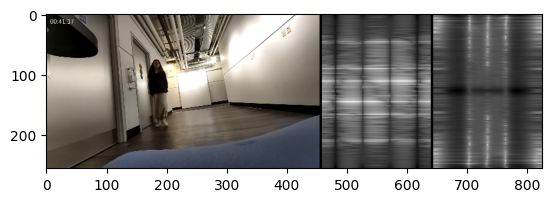

In [29]:
plt.imshow(frames_stack[210]);

In [30]:
from PIL import Image
import glob

fp_out = "../rawData/cap6/cap6_azimuth.gif" # Path to output GIF file

# Load images and create GIF
img, *imgs = [Image.fromarray(frame) for frame in frames_stack[20:]]
img.save(fp=fp_out, format='GIF', append_images=imgs, save_all=True, duration=200, loop=0)